<a href="https://colab.research.google.com/github/ylnrahma/PCVK_ganjil2023/blob/main/UJI_COBA_UAS_KTM_RAHMA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **PENGELOAHAN CITRA VISI KOMPUTER**

### -----------------**UJIAN AKHIR SEMESTER**----------------

### ---------**PENGOLAHAN CITRA PADA KTM**----------

### **KELOMPOK 7  3B-TI**

**Nama Anggota :**


1.   Indri Putri Mardiana 			  13/2141720020
2.   Mellitya Silviandro Hening		15/2141720018
3.   Yuliyana Rahmawati		        30/2141720241




## **Akses Google Drive**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
import re
import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt
import os
import matplotlib.pyplot as plt
import glob

## **Menampilkan Inputan Gambar Foto KTM dari Google Drive**

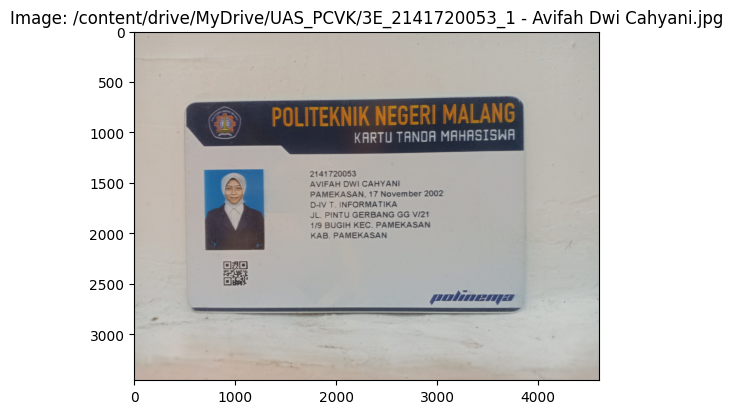

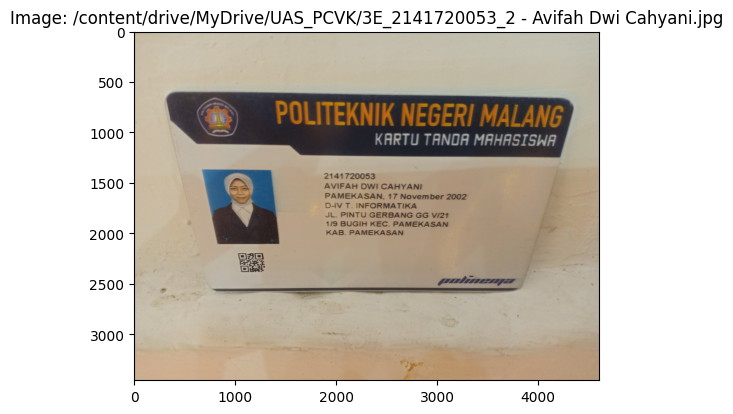

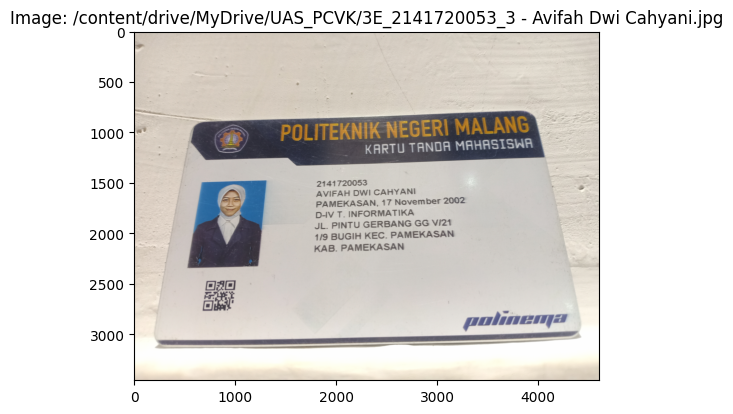

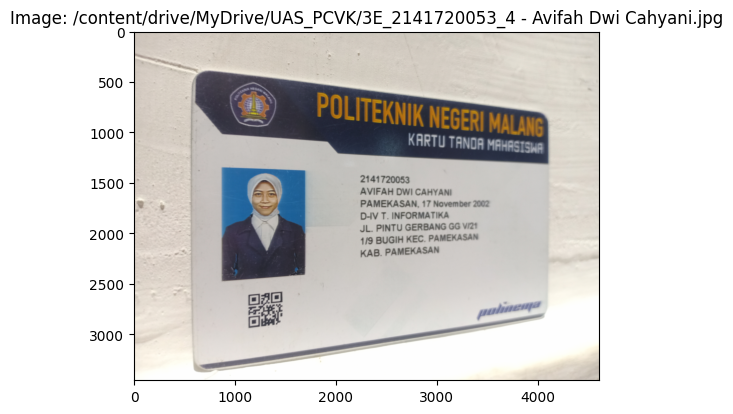

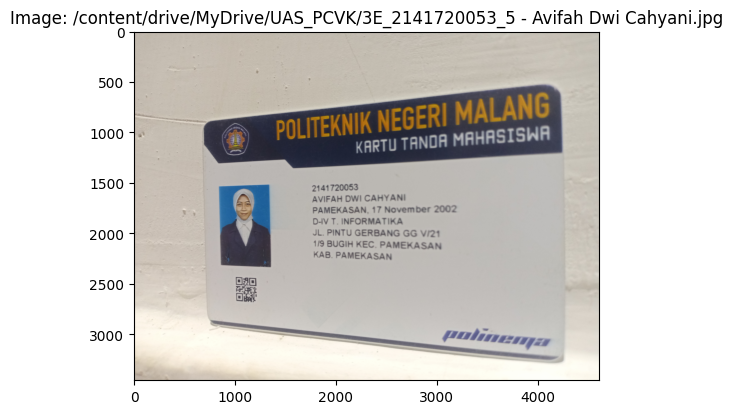

...

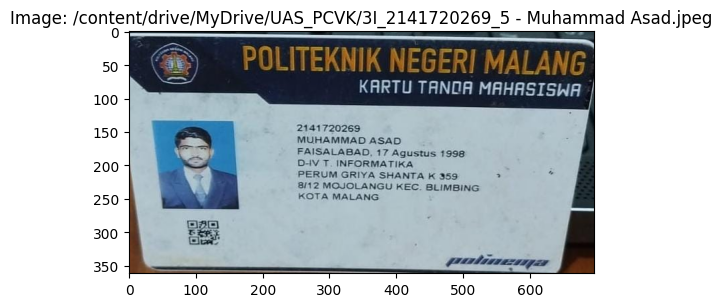

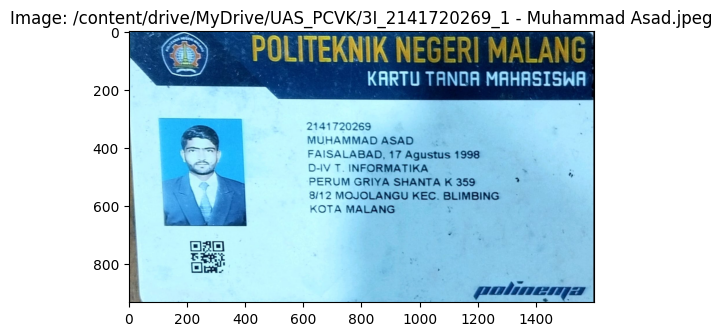

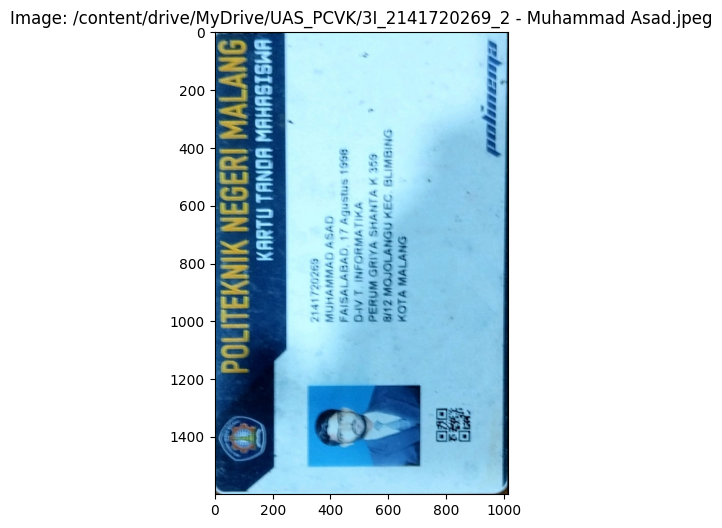

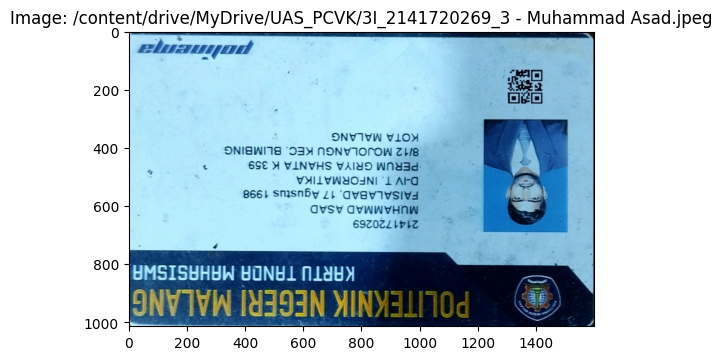

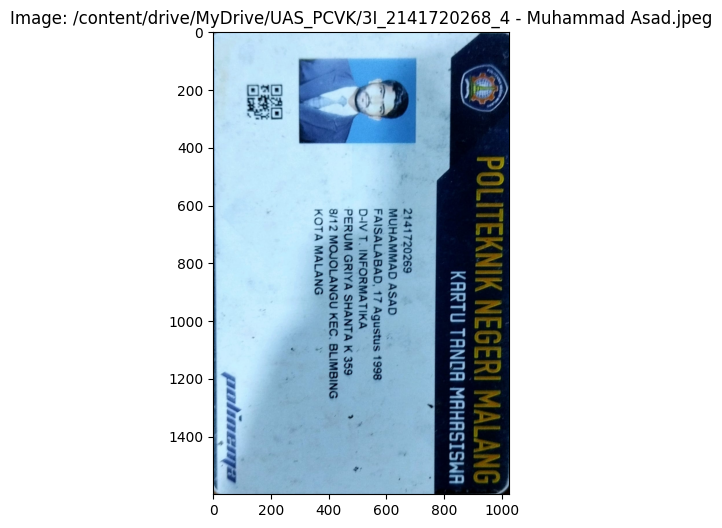

In [ ]:
# Path ke direktori yang berisi gambar dengan ekstensi .jpg
image_folder_path = '/content/drive/MyDrive/UAS_PCVK/'

# Gunakan glob untuk mendapatkan daftar file gambar dengan ekstensi .jpeg
image_files = glob.glob(image_folder_path + '*.jpg')+ glob.glob(image_folder_path + '*.jpeg')

# Loop melalui setiap file gambar dan menampilkannya
for image_path in image_files:
    # Baca gambar menggunakan OpenCV
    original_image = cv.imread(image_path)

    # Periksa apakah pembacaan gambar berhasil
    if original_image is None:
        print(f"Gambar {image_path} tidak dapat dibaca.")
    else:
        # Tampilkan gambar menggunakan matplotlib
        fig, ax = plt.subplots(figsize=(6, 6))
        ax.imshow(cv.cvtColor(original_image, cv.COLOR_BGR2RGB))
        ax.set_title(f"Image: {image_path}")
        plt.show()


## **Metode Deteksi Wajah dengan pendekatan Cascade Classifier dari OpenCV**

1 wajah terdeteksi.


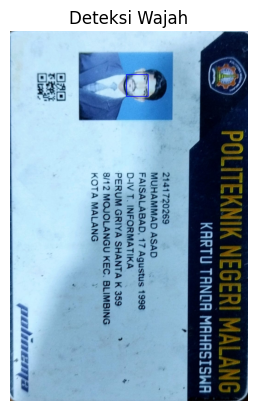

In [ ]:
import cv2
import matplotlib.pyplot as plt

# Fungsi untuk deteksi wajah menggunakan Cascade Classifier
def detect_faces(image_folder_path):
    face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray, 1.3, 5)
    return faces, img

# Path ke direktori yang berisi gambar dengan ekstensi .jpg
image_folder_path = '/content/drive/MyDrive/UAS_PCVK'

# Gunakan glob untuk mendapatkan daftar file gambar dengan ekstensi .jpeg
image_files = glob.glob(image_folder_path + '*.jpg')+ glob.glob(image_folder_path + '*.jpeg')

# Deteksi wajah pada gambar KTM
faces, image = detect_faces(image_folder_path)

if len(faces) > 0:
    print(f"{len(faces)} wajah terdeteksi.")

    # Menampilkan gambar dengan kotak deteksi wajah
    for (x, y, w, h) in faces:
        cv2.rectangle(image, (x, y), (x + w, y + h), (255, 0, 0), 2)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title('Deteksi Wajah')
    plt.show()

else:
    print("Wajah tidak terdeteksi pada gambar KTM yang dipilih.")


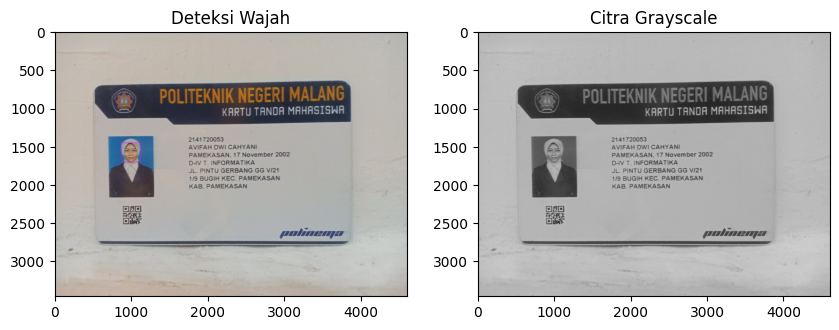

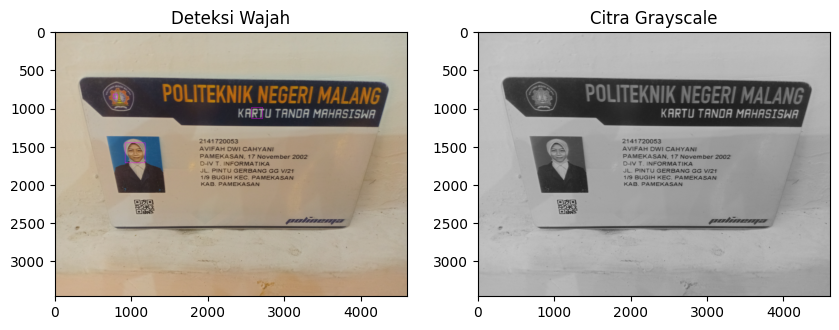

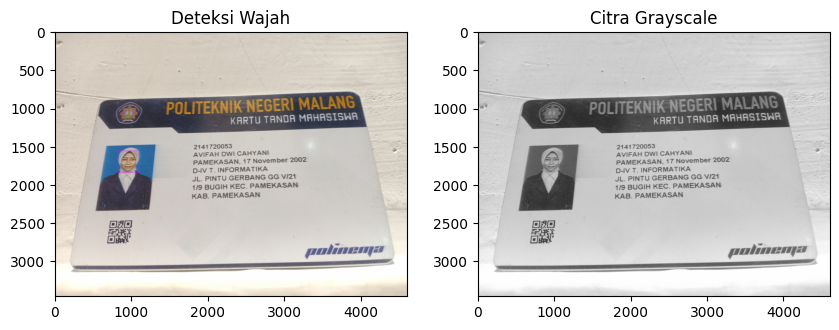

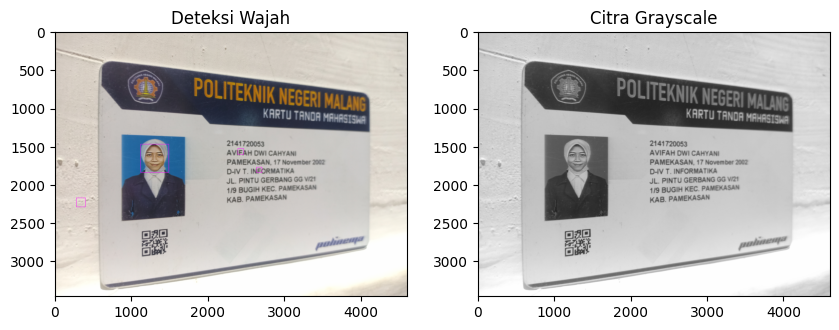

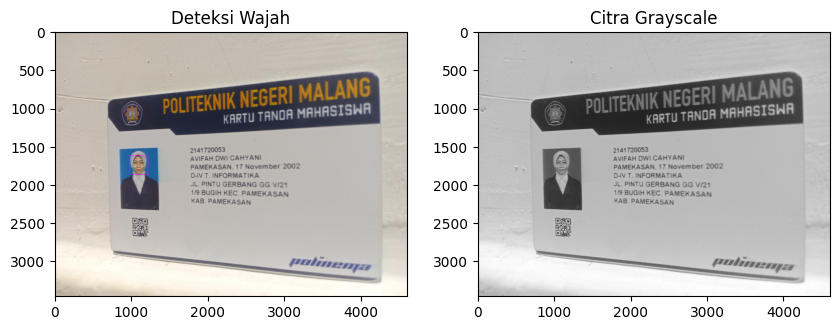

...

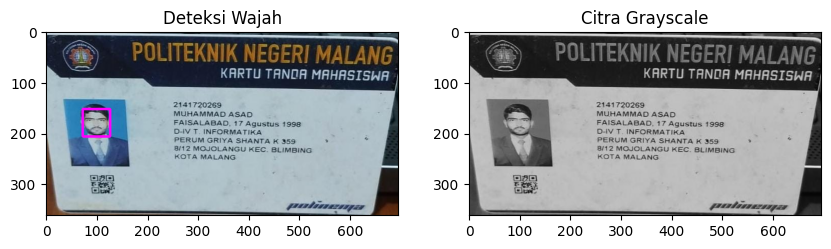

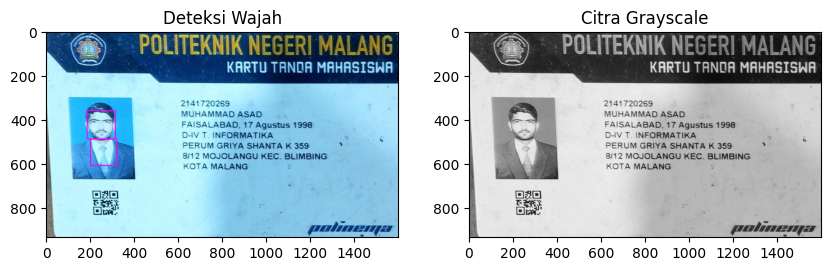

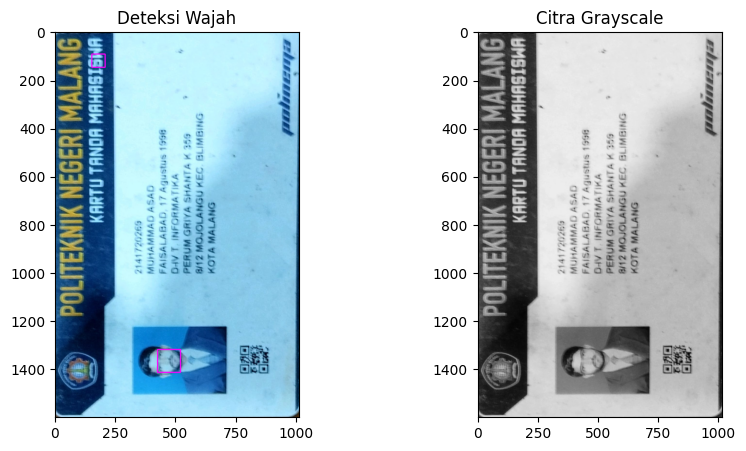

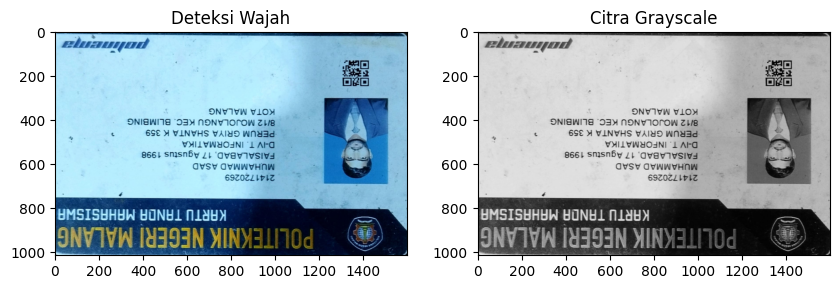

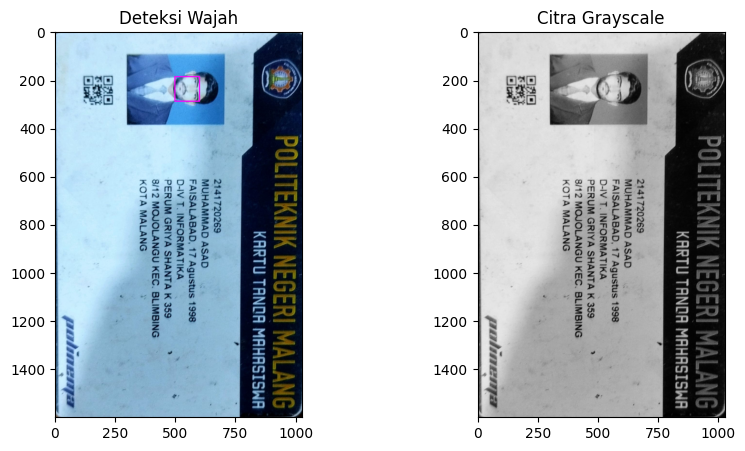

In [ ]:
import cv2 as cv
import glob
from matplotlib import pyplot as plt

cascade_wajah = cv.CascadeClassifier('/content/drive/MyDrive/UAS_PCVK/haarcascade_frontalface_default.xml')

# Path ke direktori yang berisi gambar dengan ekstensi .jpg atau .jpeg
image_folder_path = '/content/drive/MyDrive/UAS_PCVK/'

# Gunakan glob untuk mendapatkan daftar file gambar dengan ekstensi .jpg atau .jpeg
image_files = glob.glob(image_folder_path + '*.jpg') + glob.glob(image_folder_path + '*.jpeg')

for image_path in image_files:
    # Baca gambar
    ktm = cv.imread(image_path)
    ktm_gray = cv.cvtColor(ktm, cv.COLOR_BGR2GRAY)

    # Deteksi wajah
    roi_wajah = cascade_wajah.detectMultiScale(ktm_gray, scaleFactor=1.1, minNeighbors=5)

    # Gambar kotak di sekitar wajah yang terdeteksi
    for (x, y, w, h) in roi_wajah:
        cv.rectangle(ktm, (x, y), (x + w, y + h), (255, 0, 255), 3)

    # Tampilkan gambar asli dan gambar dengan kotak di sekitar wajah yang terdeteksi
    plt.figure(figsize=(10, 5))
    plt.subplot(121), plt.imshow(cv.cvtColor(ktm, cv.COLOR_BGR2RGB))
    plt.title('Deteksi Wajah')
    plt.subplot(122), plt.imshow(cv.cvtColor(ktm_gray, cv.COLOR_BGR2RGB))
    plt.title('Citra Grayscale')
    plt.show()


In [ ]:
import cv2
import os

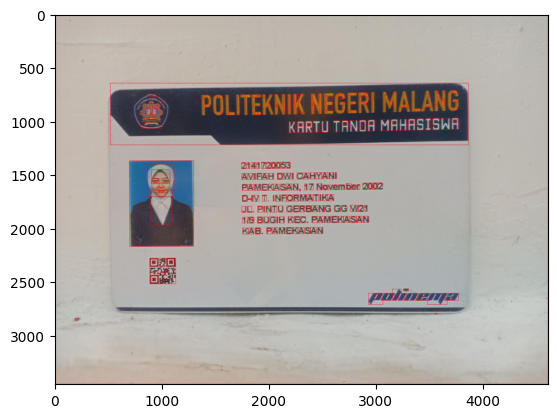

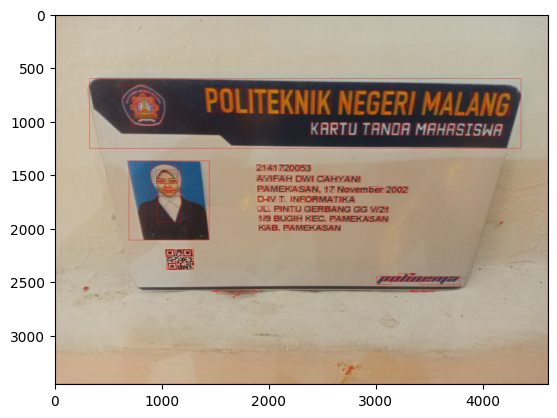

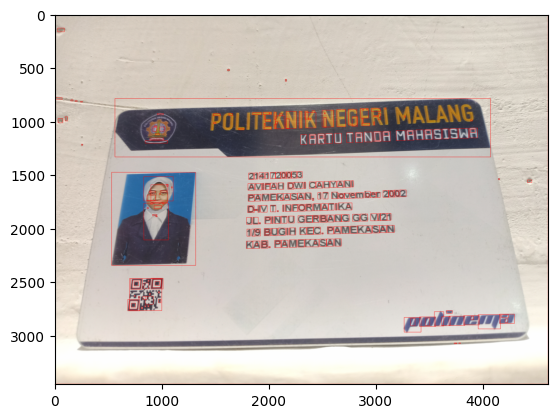

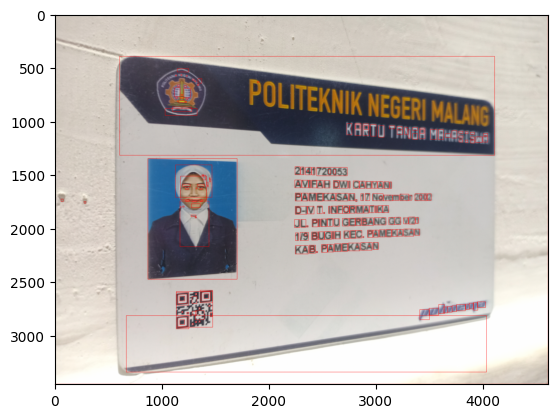

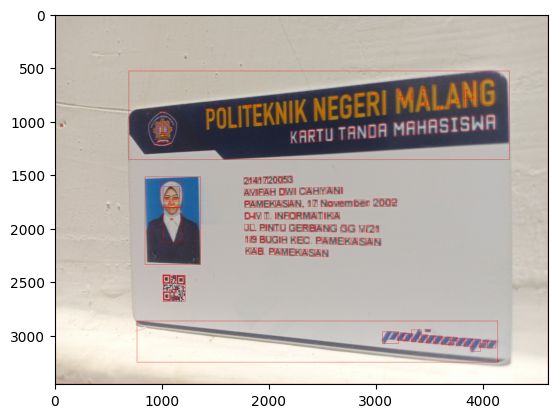

...

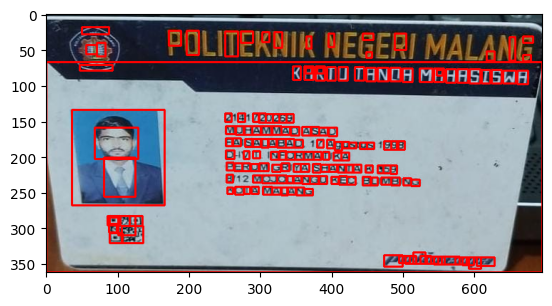

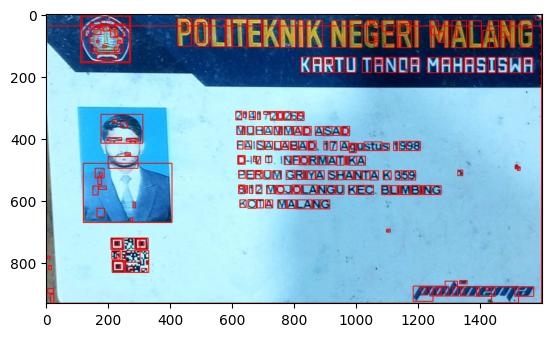

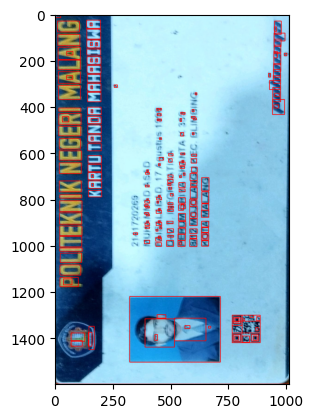

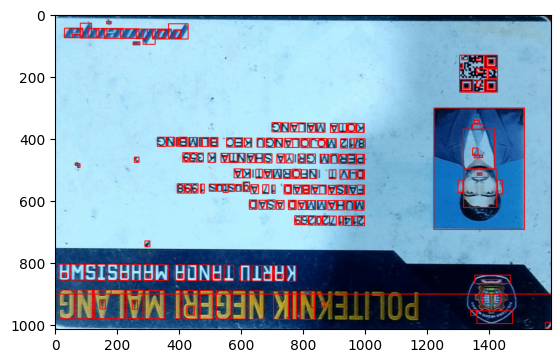

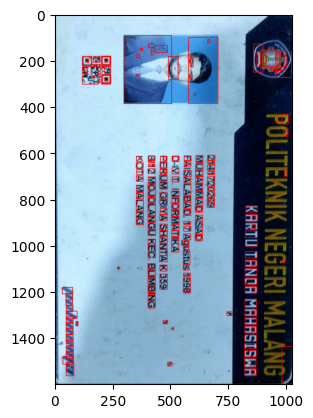

In [ ]:
import cv2 as cv
import glob
from matplotlib import pyplot as plt

# Path ke direktori yang berisi gambar dengan ekstensi .jpg atau .jpeg
image_folder_path = '/content/drive/MyDrive/UAS_PCVK/'

# Gunakan glob untuk mendapatkan daftar file gambar dengan ekstensi .jpg atau .jpeg
image_files = glob.glob(image_folder_path + '*.jpg') + glob.glob(image_folder_path + '*.jpeg')

# Looping melalui setiap file gambar
for image_path in image_files:
    # Baca gambar KTP
    ktp = cv.imread(image_path)

    # Proses pemekluran menggunakan Gaussian Blur
    blurred = cv.GaussianBlur(ktp, (5, 5), 0.5)

    # Konversi ke citra grayscale
    gray = cv.cvtColor(blurred, cv.COLOR_BGR2GRAY)

    # Thresholding citra untuk mendapatkan gambar biner
    ret, bw = cv.threshold(gray, 0, 255, cv.THRESH_BINARY + cv.THRESH_OTSU)

    # Erosi citra untuk memperbaiki hasil thresholding
    erode = cv.erode(bw, cv.getStructuringElement(cv.MORPH_OPEN, (1, 1)))

    # Ekstraksi kontur
    contours, hierarchy = cv.findContours(erode, cv.RETR_TREE, cv.CHAIN_APPROX_NONE)

    # Looping kontur
    for cnt in contours:
        x, y, w, h = cv.boundingRect(cnt)
        ras = format(w / h, '.2f')
        if h >= 40 and w >= 10 and float(ras) <= 1:
            cv.rectangle(ktp, (x, y), (x + w, y + h), (0, 0, 255), thickness=2)
        elif h >= 8 and w >= 8 and float(ras) <= 10:
            cv.rectangle(ktp, (x, y), (x + w, y + h), (0, 0, 255), thickness=2)
        elif h >= 10 and w >= 7 and float(ras) <= 8:
            cv.rectangle(ktp, (x, y), (x + w, y + h), (0, 0, 255), thickness=2)

    # Menampilkan gambar KTP dengan kontur menggunakan plt
    ktp_rgb = cv.cvtColor(ktp, cv.COLOR_BGR2RGB)
    plt.imshow(ktp_rgb)
    plt.show()


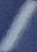

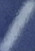

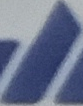

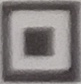

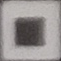

...

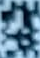

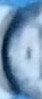

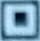

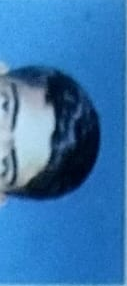

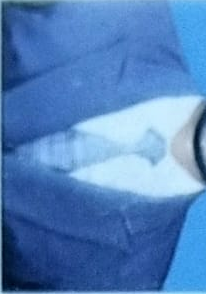

In [17]:
from google.colab.patches import cv2_imshow
import cv2 as cv
import glob

# Path ke direktori yang berisi gambar dengan ekstensi .jpg atau .jpeg
image_folder_path = '/content/drive/MyDrive/UAS_PCVK/'

# Gunakan glob untuk mendapatkan daftar file gambar dengan ekstensi .jpg atau .jpeg
image_files = glob.glob(image_folder_path + '*.jpg') + glob.glob(image_folder_path + '*.jpeg')

# Looping melalui setiap file gambar
for image_path in image_files:
    # Baca gambar KTP
    ktp = cv.imread(image_path)

    # Proses pemekluran menggunakan Gaussian Blur
    blurred = cv.GaussianBlur(ktp, (5, 5), 0.5)

    # Konversi ke citra grayscale
    gray = cv.cvtColor(blurred, cv.COLOR_BGR2GRAY)

    # Thresholding citra untuk mendapatkan gambar biner
    ret, bw = cv.threshold(gray, 0, 255, cv.THRESH_BINARY + cv.THRESH_OTSU)

    # Erosi citra untuk memperbaiki hasil thresholding
    erode = cv.erode(bw, cv.getStructuringElement(cv.MORPH_OPEN, (1, 1)))

    # Ekstraksi kontur
    contours, hierarchy = cv.findContours(erode, cv.RETR_TREE, cv.CHAIN_APPROX_NONE)

    # Looping kontur
    for cnt in contours:
        x, y, w, h = cv.boundingRect(cnt)
        ras = format(w / h, '.2f')
        if h >= 40 and w >= 10 and float(ras) <= 1:
            # Crop bagian KTM
            ktm_cropped = ktp[y:y+h, x:x+w]
            # Simpan bagian KTM ke file terpisah
            cv.imwrite(f'/content/drive/MyDrive/UAS_PCVK/ktm_cropped_{x}_{y}.jpg', ktm_cropped)

            # Tampilkan bagian KTM yang di-crop
            cv2_imshow(ktm_cropped)


<ipython-input-18-52b8e5246c04>:55: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  plt.tight_layout()


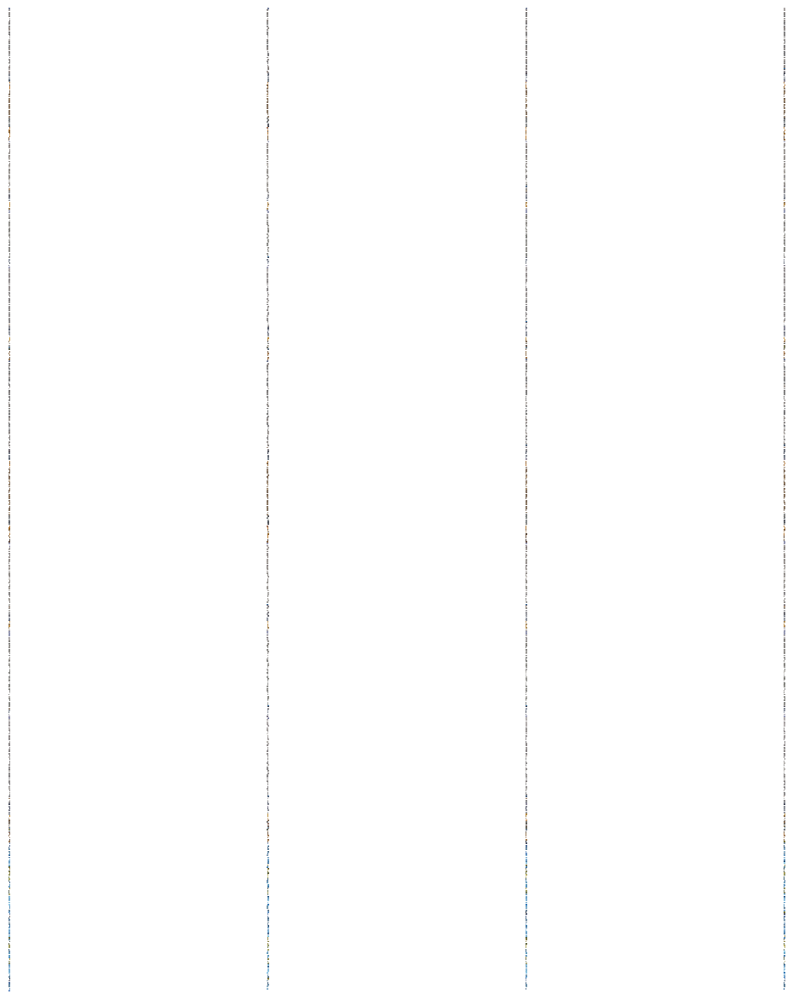

In [18]:
import cv2 as cv
import glob
import matplotlib.pyplot as plt

# Path ke direktori yang berisi gambar dengan ekstensi .jpg atau .jpeg
image_folder_path = '/content/drive/MyDrive/UAS_PCVK/'

# Gunakan glob untuk mendapatkan daftar file gambar dengan ekstensi .jpg atau .jpeg
image_files = glob.glob(image_folder_path + '*.jpg') + glob.glob(image_folder_path + '*.jpeg')

# Inisialisasi variabel untuk menyimpan gambar hasil cropping
cropped_images = []

# Looping melalui setiap file gambar
for image_path in image_files:
    # Baca gambar KTP
    ktp = cv.imread(image_path)

    # Proses pemekluran menggunakan Gaussian Blur
    blurred = cv.GaussianBlur(ktp, (5, 5), 0.5)

    # Konversi ke citra grayscale
    gray = cv.cvtColor(blurred, cv.COLOR_BGR2GRAY)

    # Thresholding citra untuk mendapatkan gambar biner
    ret, bw = cv.threshold(gray, 0, 255, cv.THRESH_BINARY + cv.THRESH_OTSU)

    # Erosi citra untuk memperbaiki hasil thresholding
    erode = cv.erode(bw, cv.getStructuringElement(cv.MORPH_OPEN, (1, 1)))

    # Ekstraksi kontur
    contours, hierarchy = cv.findContours(erode, cv.RETR_TREE, cv.CHAIN_APPROX_NONE)

    # Looping kontur
    for cnt in contours:
        x, y, w, h = cv.boundingRect(cnt)
        ras = format(w / h, '.2f')
        if h >= 40 and w >= 10 and float(ras) <= 1:
            # Crop bagian KTM
            ktm_cropped = ktp[y:y+h, x:x+w]
            # Simpan bagian KTM ke variabel cropped_images
            cropped_images.append(ktm_cropped)

# Menampilkan gambar yang di-crop dalam grid
num_images = len(cropped_images)
images_per_row = 4  # Jumlah gambar yang ingin ditampilkan per baris
num_rows = -(-num_images // images_per_row)  # Pembulatan ke atas untuk jumlah baris

plt.figure(figsize=(15, 15))
for i, image in enumerate(cropped_images):
    plt.subplot(num_rows, images_per_row, i + 1)
    plt.imshow(cv.cvtColor(image, cv.COLOR_BGR2RGB))
    plt.axis('off')

plt.tight_layout()
plt.show()


In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import zipfile

In [ ]:
from tensorflow.keras.datasets import mnist
(train_data, train_labels), (test_data, test_labels) = mnist.load_data()

11490434/11490434 [==============================] - 0s 0us/step


In [ ]:
# Check shape data
(train_data.shape, test_data.shape)

((60000, 28, 28), (10000, 28, 28))

In [ ]:
digits_data = np.vstack([train_data, test_data])
digits_labels = np.hstack([train_labels, test_labels])

Text(0.5, 1.0, 'Class: 9')

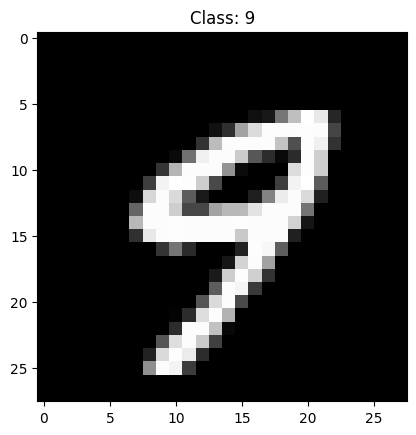

In [ ]:
# Randomly checking the data
idx = np.random.randint(0, digits_data.shape[0])
plt.imshow(digits_data[idx], cmap='gray')
plt.title('Class: ' + str(digits_labels[idx]))

<Axes: xlabel='Labels', ylabel='count'>

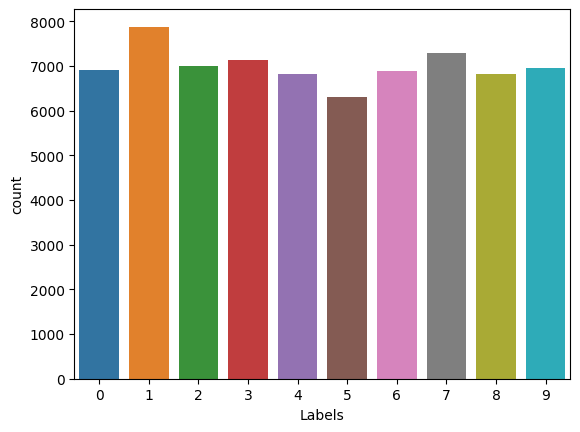

In [ ]:
# Check data distribution
df_labels = pd.DataFrame(digits_labels, columns=['Labels'])
sns.countplot(df_labels, x='Labels')

In [ ]:
!wget https://iaexpert.academy/arquivos/alfabeto_A-Z.zip

--2023-12-12 01:47:13--  https://iaexpert.academy/arquivos/alfabeto_A-Z.zip
Resolving iaexpert.academy (iaexpert.academy)... 162.159.134.42
Connecting to iaexpert.academy (iaexpert.academy)|162.159.134.42|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 193643888 (185M) [application/zip]
Saving to: ‘alfabeto_A-Z.zip’

alfabeto_A-Z.zip    100%[===================>] 184.67M   100MB/s    in 1.8s    

2023-12-12 01:47:16 (100 MB/s) - ‘alfabeto_A-Z.zip’ saved [193643888/193643888]



In [ ]:
# Extract zip file
zip_object = zipfile.ZipFile(file = 'alfabeto_A-Z.zip', mode = 'r')
zip_object.extractall('./')
zip_object.close()

In [ ]:
dataset_huruf = pd.read_csv('A_Z Handwritten Data.csv').astype('float32')
dataset_huruf

,0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,...,0.639,0.640,0.641,0.642,0.643,0.644,0.645,0.646,0.647,0.648
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
372445,25.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
372446,25.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
372447,25.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
372448,25.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
# Get pixel data only
alphabet_data = dataset_huruf.drop('0', axis=1)
# Get labels only
alphabet_labels = dataset_huruf['0']

In [ ]:
# Reshape pixel data to 28*28
alphabet_data = np.reshape(alphabet_data.values, (alphabet_data.shape[0], 28, 28))
# Check the result by its shape
alphabet_data.shape

(372450, 28, 28)

Text(0.5, 1.0, 'Class: 17.0')

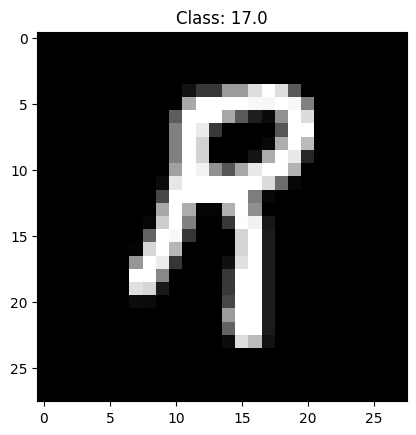

In [ ]:
# Randomly checking A-Z dataset
index = np.random.randint(0, alphabet_data.shape[0])
plt.imshow(alphabet_data[index], cmap = 'gray')
plt.title('Class: ' + str(alphabet_labels[index]))

In [ ]:
# Check unique value from digits_labels
np.unique(digits_labels)

array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=uint8)

In [ ]:
# Check unique value from alphabet_labels
np.unique(alphabet_labels)

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
       13., 14., 15., 16., 17., 18., 19., 20., 21., 22., 23., 24., 25.],
      dtype=float32)

In [ ]:
# We already know that digits labels containt labels from 0-9 (10 labels)
# We also know that alphabet labels start from 0-25 which represent A-Z
# If we want to combine them, the A-Z labels should continuing the digits label

alphabet_labels += 10

In [ ]:
# check alphabet labels again
np.unique(alphabet_labels)

array([10., 11., 12., 13., 14., 15., 16., 17., 18., 19., 20., 21., 22.,
       23., 24., 25., 26., 27., 28., 29., 30., 31., 32., 33., 34., 35.],
      dtype=float32)

In [ ]:
# Combine both of them
data = np.vstack([alphabet_data, digits_data])
labels = np.hstack([alphabet_labels, digits_labels])

In [ ]:
# Convert data to float32
data = np.array(data, dtype = 'float32')

In [ ]:
# Normalize data
data /= 255.0

Text(0.5, 1.0, '10.0')

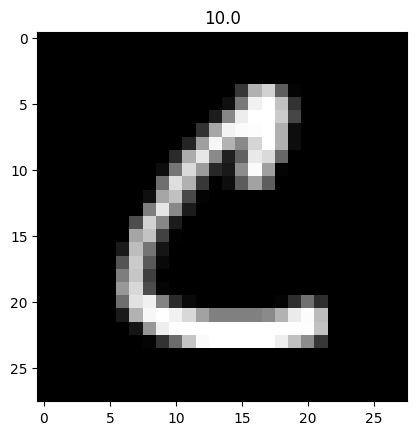

In [ ]:
# Check data with label binarizer's label
plt.imshow(data[30000].reshape(28,28), cmap='gray')
plt.title(str(labels[5]))

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size = 0.2, random_state = 1, stratify = labels)

In [ ]:
# Import library
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [ ]:
augmentation = ImageDataGenerator(rotation_range = 10, zoom_range=0.05, width_shift_range=0.1,
                                  height_shift_range=0.1, horizontal_flip = False)

In [ ]:
# Import library
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPool2D, Flatten, Dense
from tensorflow.keras.callbacks import ModelCheckpoint

In [ ]:
# Build the network
network = Sequential()

network.add(Conv2D(filters = 32, kernel_size=(3,3), activation='relu', input_shape=(28,28,1)))
network.add(MaxPool2D(pool_size=(2,2)))

network.add(Conv2D(filters = 64, kernel_size=(3,3), activation='relu', padding='same'))
network.add(MaxPool2D(pool_size=(2,2)))

network.add(Conv2D(filters = 128, kernel_size=(3,3), activation='relu', padding='valid'))
network.add(MaxPool2D(pool_size=(2,2)))

network.add(Flatten())

network.add(Dense(64, activation = 'relu'))
network.add(Dense(128, activation = 'relu'))

# output
network.add(Dense(36, activation='softmax'))

network.compile(loss = 'categorical_crossentropy', optimizer = 'adam', metrics = ['accuracy'])

In [ ]:
# Check network summary
network.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 26, 26, 32)        320       
                                                                 
 max_pooling2d (MaxPooling2  (None, 13, 13, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 13, 13, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 6, 6, 64)          0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 4, 4, 128)         73856     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 2, 2, 128)         0

In [ ]:
# Create actual labels
name_labels = '0123456789'
name_labels += 'ABCDEFGHIJKLMNOPQRSTUVWXYZ'
name_labels = [l for l in name_labels]

# Check actual label
print(name_labels)

['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z']


In [ ]:
# Set model name, epoch, and batch size
file_model = 'custom_ocr.model'
epochs = 20
batch_size = 128